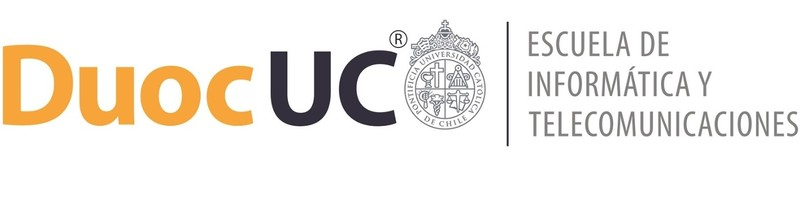

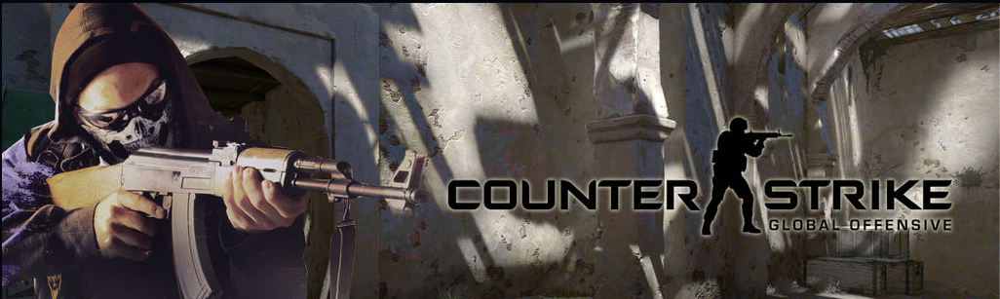

# Informe Técnico - Examen Transversal: Caso Counter Strike


Integrantes:
*
*

Docente:     

Sección: MLY0100 -

# Caso Fundamentos de Machine Learning

CONTEXTO CASO

Valve, los ha contactado como equipo de análisis de datos y modelado de Machine Learning para analizar y realizar modelos predictivos sobre los datos.

En cada partida de Counter Strike: GO dos equipos de 5 jugadores (denominados terroristas y contra-terroristas) se enfrentan.


El objetivo del equipo terrorista es plantar una bomba con timer de 45 segundos en uno de dos sitios específicos dentro de un mapa. Por otro lado, el objetivo del equipo contra-terrorista es evitar que la bomba sea plantada o desactivarla antes de que esta explote cuando ya ha sido plantada. Los datos a utilizar corresponden a sobre 7000 partidas del juego (con un máximo de 10 jugadores c/u)  


Los datos han sido extraídos de replays, los cuales son archivos propietarios con la información de cada una de las acciones realizadas por cada jugador dentro de una partida. Los replays han sido extraídos de la red utilizando un scrapper y pre-procesados utilizando un script.  



En este caso, la data corresponde a un archivo CSV con 79.157 filas, cada una correspondiente a un jugador dentro de una partida. El archivo contiene 29 columnas correspondientes a variables que describen las acciones del jugador dentro del juego.


$$
\begin{aligned}
&\begin{array}{cccc}
\hline \hline \text { Dato } & \text { Descripción } \\
\hline Map & \text {Nombre  del Mapa donde se jugó la partida}  \\
\hline \text{ Team} & \text { Nombre de equipo al que pertenece el jugador} \\
\hline \text{ InternalTeamId} & \text { Identificador del equipo al que pertenece el jugador.} \\
\hline \text{ MatchId} & \text { Identificador de la partida.} \\
\hline \text{ RoundId} & \text { Identificador de la ronda (los equipos se enfrentan en rondas de 5 partidas seguidas)} \\
\hline \text{ MatchWinner} & \text { Indica si el jugador ganó o no la partida.} \\
\hline \text{ RoundWinner} & \text { Indica si el jugador ganó o no la ronda analizada.} \\
\hline \text{ Survived} & \text { Indica si el jugador sobrevivió o no a la partida (sobrevivir no es sinónimo de ganar).} \\
\hline \text{ AbnormalMatch} & \text { Indica si la partida del jugador tuvo un error por conexión de red} \\
\hline \text{ TimeAlive} & \text { Indica el tiempo en segundos que el jugador estuvo vivo durante el juego} \\
\hline \text{ TravelledDistance} & \text { Distancia viajada por el jugador durante la partida.} \\
\hline \text{ RLethalGrenadesThrown/RNonLethalGrenadesThrown} & \text { Cantidad de granadas lanzadas, categorizadas en letales y no-letales.} \\
\hline \text{ PrimaryXXXX} & \text { Porcentaje de uso arma clasificada como primaria. Categorizada en AssaultRifle, SniperRifle, SMG, Heavy y Pistol.} \\
\hline \text{ [Match|Round] Assists} & \text { Cantidad de asistencias efectuadas por el jugador durante la partida o la ronda.} \\
\hline \text{ [Match|Round] Kills} & \text { Cantidad de kills efectuados por el jugador durante la partida o la ronda.} \\
\hline \text{ [Match|Round] FlankKills} & \text { Cantidad de kills efectuados por el jugador sin que la víctima lo viese durante la partida o la ronda.} \\
\hline \text{ [Match|Round] HeadShots} & \text { Cantidad de kills efectuados por el jugador a través de un tiro en la cabeza durante la partida o la ronda.} \\
\hline \text{ RoundStartingEquipmentValue} & \text { Valor del equipamiento llevado por el jugador al inicio de la ronda.} \\
\hline \text{ TeamStartingEquipmentValue} & \text { Valor promedio del equipamiento llevado por el equipo del jugador al inicio de la ronda.} \\
\end{array}
\end{aligned}
$$

## Fase 1: Business Understanding

In [ ]:
# Se importan las librerías

import numpy as np # Programación vectorial
import matplotlib.pyplot as plt # Visualización
import pandas as pd # Estructura y manipulación de datos
import seaborn as sns #Para crear gráficos estadísticos

In [ ]:
#Se Carga Archivo si se abre en visual studio code en local

df = pd.read_csv("ET_demo_round_traces_2022.csv", sep=",")
df.head(10)

NameError: ignored

In [ ]:
#cargamos los datos si estamos en google colab
from google.colab import files
uploaded = files.upload()
for fn in uploaded.keys():
    name=fn
train = pd.read_csv(name, sep=",")

**Al ser los datos relevantes booleanos, se transforman datos en entero para poder realizar análisis estadísticos y de medidas de tendencia central.**

In [ ]:
#Media de todas las columnas
df.mean()

TypeError: can only concatenate str (not "int") to str

In [ ]:
# Mediana de todas las columnas
df.median()

<ipython-input-6-56408701dbe4>:2: FutureWarning: The default value of numeric_only in DataFrame.median is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  df.median()


Unnamed: 0                     5.672050e+04
InternalTeamId                 1.500000e+00
MatchId                        2.360000e+02
RoundId                        1.200000e+01
RoundWinnerBoolean             0.000000e+00
RoundWinnerInt                 0.000000e+00
MatchWinnerBoolean             0.000000e+00
MatchWinnerInt                 0.000000e+00
SurvivedBoolean                0.000000e+00
SurvivedInt                    0.000000e+00
AbnormalMatchBoolean           0.000000e+00
AbnormalMatchInt               0.000000e+00
TimeAlive                      7.660043e+15
TravelledDistance              8.770581e+15
RLethalGrenadesThrown          0.000000e+00
RNonLethalGrenadesThrown       1.000000e+00
PrimaryAssaultRifle            1.000000e+00
PrimarySniperRifle             0.000000e+00
PrimaryHeavy                   0.000000e+00
PrimarySMG                     0.000000e+00
PrimaryPistol                  0.000000e+00
FirstKillTime                  2.162510e+08
RoundKills                     0

In [ ]:
#Moda de todas las columnas
df.mode()

,Unnamed: 0,Map,Team,InternalTeamId,MatchId,RoundId,RoundWinnerBoolean,RoundWinnerInt,MatchWinnerBoolean,MatchWinnerInt,...,RoundKills,RoundAssists,RoundHeadshots,RoundFlankKills,RoundStartingEquipmentValue,TeamStartingEquipmentValue,MatchKills,MatchFlankKills,MatchAssists,MatchHeadshots
0,600,de_inferno,Terrorist,1.0,29.0,1.0,False,0.0,False,0.0,...,0.0,0.0,0.0,0.0,4700.0,23500.0,2.0,0.0,0.0,1.0
1,601,NaN,NaN,2.0,NaN,2.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,602,NaN,NaN,NaN,NaN,4.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,603,NaN,NaN,NaN,NaN,5.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,604,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
79151,123775,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
79152,123776,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
79153,123777,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
79154,123778,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df.Team.describe()

count         79154
unique            2
top       Terrorist
freq          39591
Name: Team, dtype: object

In [ ]:
# Se extraen lista de columnas
df[["Team","MatchWinner","RoundWinner","Survived"]]

,Team,MatchWinner,RoundWinner,Survived
0,Terrorist,1,1,0
1,Terrorist,1,1,0
2,Terrorist,1,1,0
3,Terrorist,1,1,0
4,Terrorist,1,1,1
...,...,...,...,...
79151,CounterTerrorist,0,0,0
79152,CounterTerrorist,0,0,0
79153,CounterTerrorist,0,0,0
79154,CounterTerrorist,0,0,0


Con un total de 79.154 partidas, con 2 equipos participantes, el equipo Terrorist es quien posee mas partidas con un total de 39.591.

In [ ]:
# Se agrupan los datos por equipo considerando los partidos ganados vs los Round ganador
grouped_df = df[["RoundWinnerInt","MatchWinnerInt", "Team"]].groupby(by = "Team")
grouped_df.agg("sum")

,RoundWinnerInt,MatchWinnerInt
Team,,
CounterTerrorist,16739,17560
Terrorist,22828,19578


Según la agrupación de datos, el equipo Terrorist es el equipo con mas round y partidas ganadas. Se podría considerar que existe una relación entre estas dos variables.

In [ ]:
# Se agrupan los datos por equipo considerando los partidos ganados vs los Round ganador y los sobrevivientes
grouped_df = df[["RoundWinnerInt","MatchWinnerInt", "Team", "SurvivedInt"]].groupby(by = "Team")
grouped_df.agg("sum")

,RoundWinnerInt,MatchWinnerInt,SurvivedInt
Team,,,
CounterTerrorist,16739,17560,18558
Terrorist,22828,19578,13383


Según los datos agrupados, no se puede establecer una relación entre los partidos y round ganados vs la sobrevivencia del jugador en cada partida.

In [ ]:
df.RoundWinnerBoolean.describe()

count     79156
unique        2
top       False
freq      39588
Name: RoundWinnerBoolean, dtype: object

De un total de 79.155 round, 39588 de estas corresponde a round perdidos.

In [ ]:
df.MatchWinnerBoolean.describe()

count     79156
unique        2
top       False
freq      42017
Name: MatchWinnerBoolean, dtype: object

De un total de 79.155 partidas, 42.109 de estas corresponde a partidas perdidos.

In [ ]:
df.SurvivedBoolean.describe()

count     79156
unique        2
top       False
freq      47214
Name: SurvivedBoolean, dtype: object

De un total de 79.155 partidas, en 47.214 el jugador no sobrevivió a la partida.

In [ ]:
df.Map.describe()

count          79156
unique             4
top       de_inferno
freq           28868
Name: Map, dtype: object

De un total de 79156 partidas, de un total de 4 mapas, el mapa mas utilizado fue de_inferno con un total de 28868 partidas.

In [ ]:
# Se agrupan los datos por equipo considerando los partidos ganados vs los Round ganador y los sobrevivientes
grouped_df = df[["Map","MatchWinnerInt"]].groupby(by = "Map")
grouped_df.agg("sum")

,MatchWinnerInt
Map,
de_dust2,9050
de_inferno,13099
de_mirage,9215
de_nuke,5775


Las partidas jugadas en el mapa de_inferno fueron las que presentan mas partidas ganados.

## Fase 2: Data Understanding

In [ ]:
# Se importan las librerías

import numpy as np # Programación vectorial
import matplotlib.pyplot as plt # Visualización
import pandas as pd # Estructura y manipulación de datos
import seaborn as sns #Para crear gráficos estadísticos

Diagramas comparando dos variables

<Axes: xlabel='Team'>

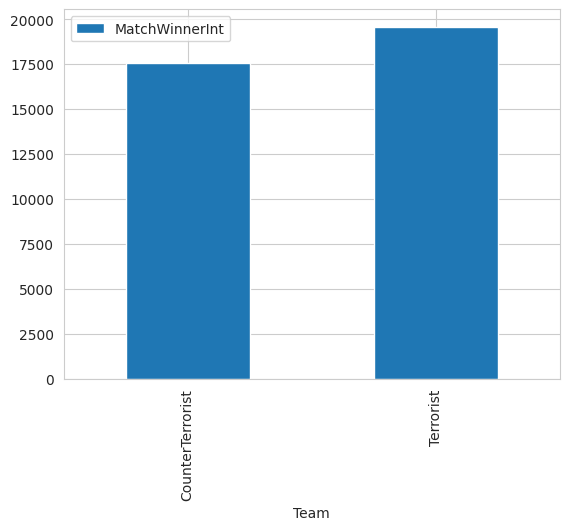

In [ ]:
#Equipo vs Partidos Ganados
df.groupby('Team')['MatchWinnerInt'].sum().plot(kind='bar',legend='Reverse')

<Axes: xlabel='Team'>

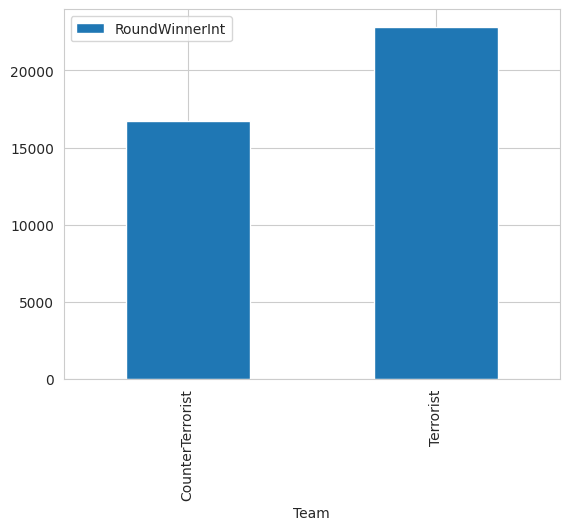

In [ ]:
#Equipo vs Round Ganados
sns.set_style('whitegrid')
df.groupby('Team')['RoundWinnerInt'].sum().plot(kind='bar',legend='Reverse')

<Axes: xlabel='Team'>

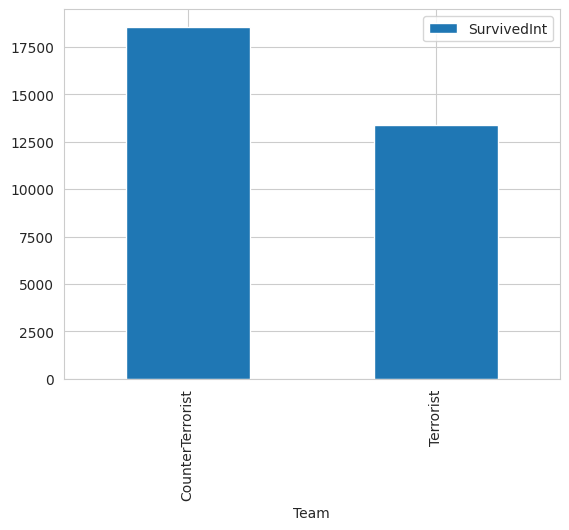

In [ ]:
# Equipo vs Sobrevivientes
sns.set_style('whitegrid')
df.groupby('Team')['SurvivedInt'].sum().plot(kind='bar',legend='Reverse')

<Axes: xlabel='Team'>

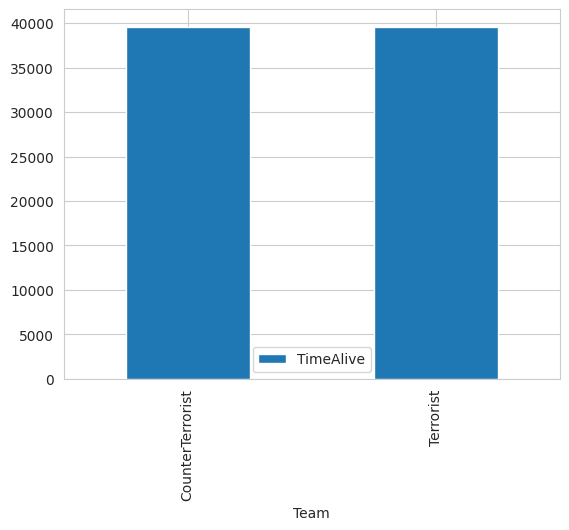

In [ ]:
# Equipo vs Segundos que el jugador estuvo vivo durante la partida
sns.set_style('whitegrid')
df.groupby('Team')['TimeAlive'].count().plot(kind='bar',legend='Reverse')

<Axes: xlabel='Team'>

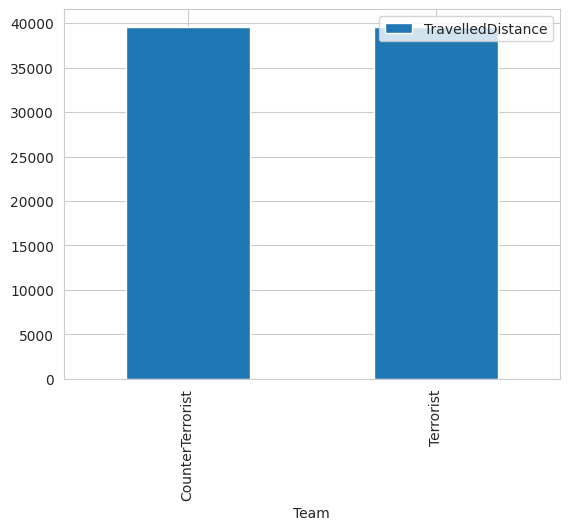

In [ ]:
#Equipo vs Distancia viajada por el jugador
sns.set_style('whitegrid')
df.groupby('Team')['TravelledDistance'].count().plot(kind='bar',legend='Reverse')

<Axes: xlabel='Map'>

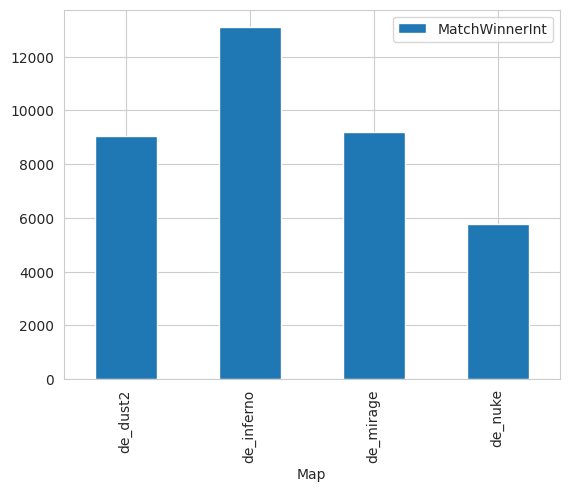

In [ ]:
#Mapa vs Partidos Ganados
sns.set_style('whitegrid')
df.groupby('Map')['MatchWinnerInt'].sum().plot(kind='bar',legend='Reverse')

<Axes: xlabel='Map'>

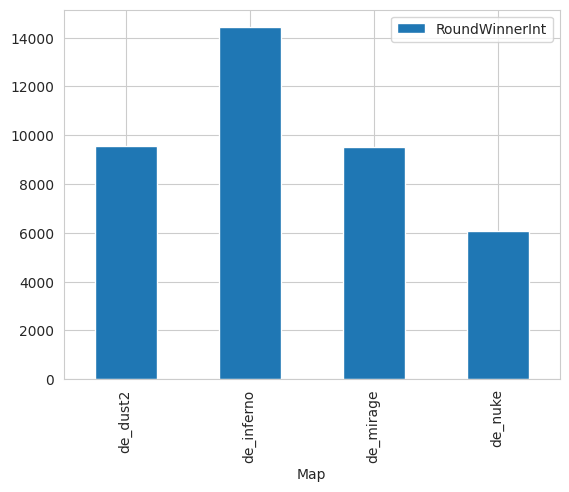

In [ ]:
#Equipo vs Round Ganado
sns.set_style('whitegrid')
df.groupby('Map')['RoundWinnerInt'].sum().plot(kind='bar',legend='Reverse')

<Axes: xlabel='Map'>

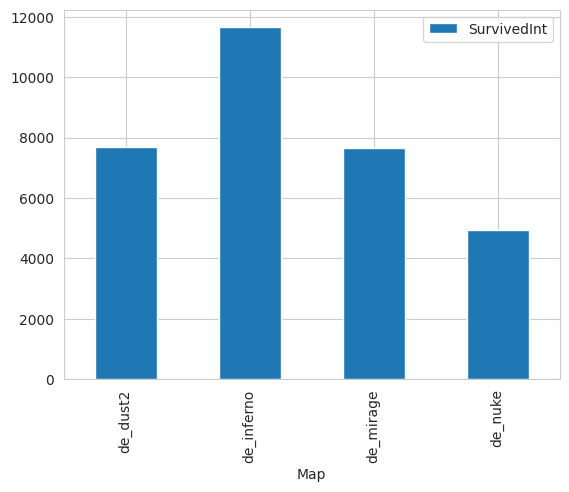

In [ ]:
#Mapa vs Sobrevivientes
sns.set_style('whitegrid')
df.groupby('Map')['SurvivedInt'].sum().plot(kind='bar',legend='Reverse')

<Axes: xlabel='Map'>

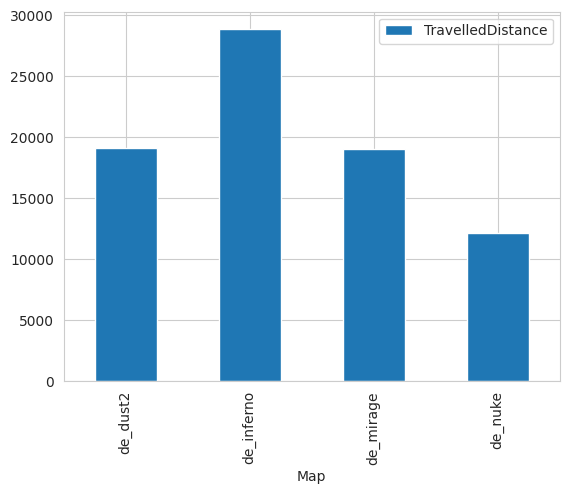

In [ ]:
#Mapa vs Distancia viajada por el jugador
sns.set_style('whitegrid')
df.groupby('Map')['TravelledDistance'].count().plot(kind='bar',legend='Reverse')

<Axes: xlabel='Map'>

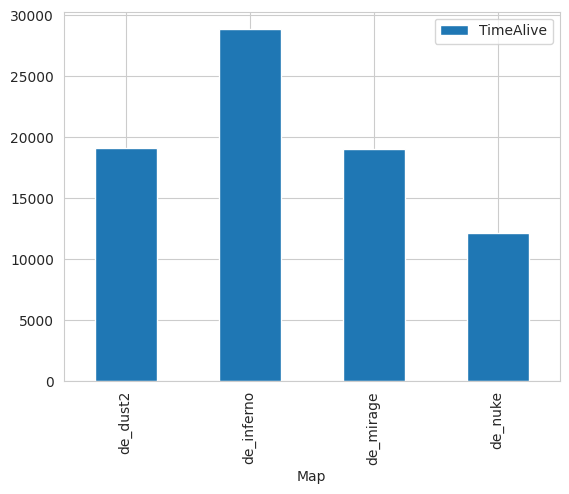

In [ ]:
#Mapa vs Segundos que el jugador estuvo vivo durante la partida
sns.set_style('whitegrid')
df.groupby('Map')['TimeAlive'].count().plot(kind='bar',legend='Reverse')

Error in callback <function _draw_all_if_interactive at 0x7f003ac64700> (for post_execute):


KeyboardInterrupt: ignored

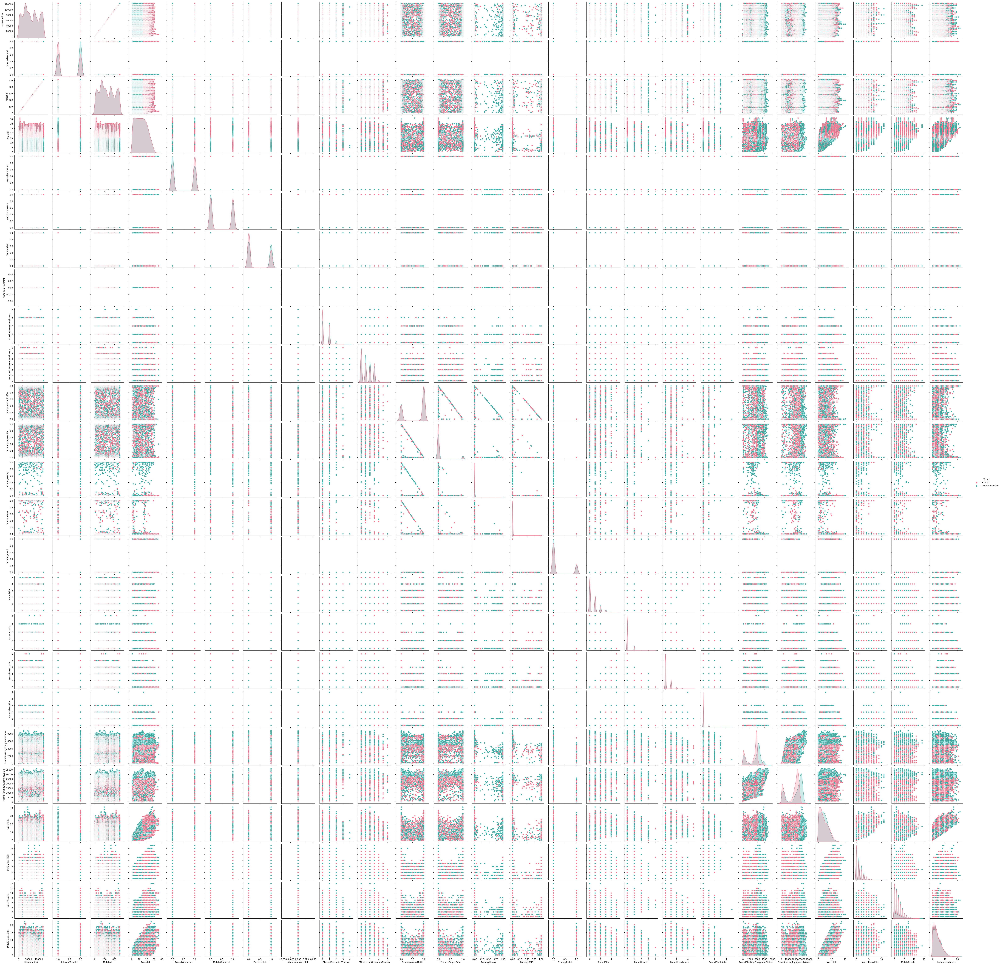

In [ ]:
#Graficos Resumidos

par=sns.pairplot(df,  hue = "Team" , palette = "husl")

## Fase 3: Data Preparation

In [ ]:
#Se Carga Archivo

from google.colab import files
uploaded = files.upload()
for fn in uploaded.keys():
    name=fn
df = pd.read_csv(name, sep=",")
df.head(10)

Saving ET_demo_round_traces_2022.csv to ET_demo_round_traces_2022.csv


<ipython-input-2-8a1e8e4f4c1f>:7: DtypeWarning: Columns (6,7) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(name, sep=",")


,Unnamed: 0,Map,Team,InternalTeamId,MatchId,RoundId,RoundWinner,MatchWinner,Survived,AbnormalMatch,...,RoundKills,RoundAssists,RoundHeadshots,RoundFlankKills,RoundStartingEquipmentValue,TeamStartingEquipmentValue,MatchKills,MatchFlankKills,MatchAssists,MatchHeadshots
0,600,de_inferno,Terrorist,1,4,1,FALSE,True,False,False,...,0,0,0,0,750,4400,0,0,0,0
1,601,de_inferno,Terrorist,1,4,1,FALSE,True,False,False,...,0,0,0,0,800,4400,0,0,0,0
2,602,de_inferno,Terrorist,1,4,1,FALSE,True,False,False,...,0,0,0,0,1000,4400,0,0,0,0
3,603,de_inferno,Terrorist,1,4,1,FALSE,True,False,False,...,0,0,0,0,850,4400,0,0,0,0
4,604,de_inferno,Terrorist,1,4,1,FALSE,True,True,False,...,0,0,0,0,1000,4400,0,0,0,0
5,605,de_inferno,CounterTerrorist,2,4,1,TRUE,False,True,False,...,0,0,0,0,850,3750,0,0,0,0
6,606,de_inferno,CounterTerrorist,2,4,1,TRUE,False,True,False,...,0,0,0,0,400,3750,0,0,0,0
7,607,de_inferno,CounterTerrorist,2,4,1,TRUE,False,True,False,...,0,1,0,0,800,3750,0,0,1,0
8,608,de_inferno,CounterTerrorist,2,4,1,TRUE,False,True,False,...,3,0,1,1,850,3750,3,1,0,1
9,609,de_inferno,CounterTerrorist,2,4,1,TRUE,False,True,False,...,2,0,2,0,850,3750,2,0,0,2


In [ ]:
# Se revisa y verican cuantos datos nulos tieene cada columna del dataframe
for feature in df.columns:
  print('Total de valores nulos de', feature, '=', df[feature].isna().sum())

Total de valores nulos de Unnamed: 0 = 0
Total de valores nulos de Map = 0
Total de valores nulos de Team = 2
Total de valores nulos de InternalTeamId = 0
Total de valores nulos de MatchId = 0
Total de valores nulos de RoundId = 0
Total de valores nulos de RoundWinner = 0
Total de valores nulos de MatchWinner = 1
Total de valores nulos de Survived = 0
Total de valores nulos de AbnormalMatch = 0
Total de valores nulos de TimeAlive = 0
Total de valores nulos de TravelledDistance = 0
Total de valores nulos de RLethalGrenadesThrown = 0
Total de valores nulos de RNonLethalGrenadesThrown = 0
Total de valores nulos de PrimaryAssaultRifle = 0
Total de valores nulos de PrimarySniperRifle = 0
Total de valores nulos de PrimaryHeavy = 0
Total de valores nulos de PrimarySMG = 0
Total de valores nulos de PrimaryPistol = 0
Total de valores nulos de FirstKillTime = 0
Total de valores nulos de RoundKills = 0
Total de valores nulos de RoundAssists = 0
Total de valores nulos de RoundHeadshots = 0
Total d

In [ ]:
# Se eliminan filas con valores nulos
df = df.dropna()

# Verificamos que se aplica correctamente

for feature in df.columns:
  print('Total de valores nulos de', feature, '=', df[feature].isna().sum())


Total de valores nulos de Unnamed: 0 = 0
Total de valores nulos de Map = 0
Total de valores nulos de Team = 0
Total de valores nulos de InternalTeamId = 0
Total de valores nulos de MatchId = 0
Total de valores nulos de RoundId = 0
Total de valores nulos de RoundWinner = 0
Total de valores nulos de MatchWinner = 0
Total de valores nulos de Survived = 0
Total de valores nulos de AbnormalMatch = 0
Total de valores nulos de TimeAlive = 0
Total de valores nulos de TravelledDistance = 0
Total de valores nulos de RLethalGrenadesThrown = 0
Total de valores nulos de RNonLethalGrenadesThrown = 0
Total de valores nulos de PrimaryAssaultRifle = 0
Total de valores nulos de PrimarySniperRifle = 0
Total de valores nulos de PrimaryHeavy = 0
Total de valores nulos de PrimarySMG = 0
Total de valores nulos de PrimaryPistol = 0
Total de valores nulos de FirstKillTime = 0
Total de valores nulos de RoundKills = 0
Total de valores nulos de RoundAssists = 0
Total de valores nulos de RoundHeadshots = 0
Total d

In [ ]:
# Revisamos qué tipo de datos contien cada columna del dataframe
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 79153 entries, 0 to 79155
Data columns (total 30 columns):
 #   Column                       Non-Null Count  Dtype 
---  ------                       --------------  ----- 
 0   Unnamed: 0                   79153 non-null  int64 
 1   Map                          79153 non-null  object
 2   Team                         79153 non-null  object
 3   InternalTeamId               79153 non-null  int64 
 4   MatchId                      79153 non-null  int64 
 5   RoundId                      79153 non-null  int64 
 6   RoundWinner                  79153 non-null  object
 7   MatchWinner                  79153 non-null  object
 8   Survived                     79153 non-null  bool  
 9   AbnormalMatch                79153 non-null  bool  
 10  TimeAlive                    79153 non-null  object
 11  TravelledDistance            79153 non-null  object
 12  RLethalGrenadesThrown        79153 non-null  int64 
 13  RNonLethalGrenadesThrown     79

In [ ]:
# Hacemos una copia de nuestro dataframe original,  en donde ingresaremos los valores anteriormente transformados y así, en caso de rror, no volver a cargar el dataframe e iniciar todo el procesamiento nuevamente
dft = df

dft.head()

,Unnamed: 0,Map,Team,InternalTeamId,MatchId,RoundId,RoundWinner,MatchWinner,Survived,AbnormalMatch,...,RoundKills,RoundAssists,RoundHeadshots,RoundFlankKills,RoundStartingEquipmentValue,TeamStartingEquipmentValue,MatchKills,MatchFlankKills,MatchAssists,MatchHeadshots
0,600,de_inferno,Terrorist,1,4,1,FALSE,True,False,False,...,0,0,0,0,750,4400,0,0,0,0
1,601,de_inferno,Terrorist,1,4,1,FALSE,True,False,False,...,0,0,0,0,800,4400,0,0,0,0
2,602,de_inferno,Terrorist,1,4,1,FALSE,True,False,False,...,0,0,0,0,1000,4400,0,0,0,0
3,603,de_inferno,Terrorist,1,4,1,FALSE,True,False,False,...,0,0,0,0,850,4400,0,0,0,0
4,604,de_inferno,Terrorist,1,4,1,FALSE,True,True,False,...,0,0,0,0,1000,4400,0,0,0,0


In [ ]:
# Convertir las columnas object a bool
dft["RoundWinner"] = dft["RoundWinner"].astype('bool')
dft["MatchWinner"] = dft["MatchWinner"].astype('bool')
dft["Survived"] = dft["Survived"].astype('bool')
dft["AbnormalMatch"] = dft["AbnormalMatch"].astype('bool')


# Luego las columnas bool las pasamos a int64
dft["RoundWinner"] = dft["RoundWinner"].astype('int64')
dft["MatchWinner"] = dft["MatchWinner"].astype('int64')
dft["Survived"] = dft["Survived"].astype('int64')
dft["AbnormalMatch"] = dft["AbnormalMatch"].astype('int64')


In [ ]:
dft.head()

,Unnamed: 0,Map,Team,InternalTeamId,MatchId,RoundId,RoundWinner,MatchWinner,Survived,AbnormalMatch,...,RoundKills,RoundAssists,RoundHeadshots,RoundFlankKills,RoundStartingEquipmentValue,TeamStartingEquipmentValue,MatchKills,MatchFlankKills,MatchAssists,MatchHeadshots
0,600,de_inferno,Terrorist,1,4,1,1,1,0,0,...,0,0,0,0,750,4400,0,0,0,0
1,601,de_inferno,Terrorist,1,4,1,1,1,0,0,...,0,0,0,0,800,4400,0,0,0,0
2,602,de_inferno,Terrorist,1,4,1,1,1,0,0,...,0,0,0,0,1000,4400,0,0,0,0
3,603,de_inferno,Terrorist,1,4,1,1,1,0,0,...,0,0,0,0,850,4400,0,0,0,0
4,604,de_inferno,Terrorist,1,4,1,1,1,1,0,...,0,0,0,0,1000,4400,0,0,0,0


In [ ]:
dft.isnull().any().any()

True

In [ ]:
# Para poder trabajar de forma correcta el dataframe, debes convertir algunas columnas en valores numéricos. Estas columnas son:
# OBJECT: TimeAlive, TravelledDistance, PrimaryAssaultRifle, PrimarySniperRifle, PrimaryHeavy, PrimarySMG, FirstKillTime

# Selecciona solo las características que se van a considerar en los posteriores análisis
X = dft.iloc[:, 10:-1].values
# La ùltima columna (sale o no sale) se separa del resto para analizar la relación que tiene ella con el resto
y = dft.iloc[:, -1].values

In [ ]:
pd.DataFrame(X).head(10)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18
0,51.120.248.995.704.500,10.083.140.737.457.000,0,4,0.0,0.0,0.0,0.0,1,0.0,0,0,0,0,750,4400,0,0,0
1,4.348.662.552.266.170,60.960.883.184.688.400,0,0,0.0,0.0,0.0,0.0,1,0.0,0,0,0,0,800,4400,0,0,0
2,3.735.469.847.054.540,5.642.252.383.582.750,0,0,0.0,0.0,0.0,0.0,1,0.0,0,0,0,0,1000,4400,0,0,0
3,4.767.886.136.441.470,8.963.473.313.229.970,0,0,0.0,0.0,0.0,0.0,1,0.0,0,0,0,0,850,4400,0,0,0
4,5.312.251.089.027.310,10.865.649.734.393.100,1,1,0.0,0.0,0.0,0.0,1,0.0,0,0,0,0,1000,4400,0,0,0
5,5.312.251.089.027.310,889.485.801.774.066,0,0,0.0,0.0,0.0,0.0,1,0.0,0,0,0,0,850,3750,0,0,0
6,5.312.251.089.027.310,8.089.617.569.295.990,0,2,0.0,0.0,0.0,0.0,1,0.0,0,0,0,0,400,3750,0,0,0
7,5.312.251.089.027.310,6.885.879.208.139.740,0,0,0.0,0.0,0.0,0.0,1,0.0,0,1,0,0,800,3750,0,0,1
8,5.312.251.089.027.310,8.772.206.210.917.240,0,0,0.0,0.0,0.0,0.0,1,373.547,3,0,1,1,850,3750,3,1,0
9,5.312.251.089.027.310,7.849.180.428.641.930,0,0,0.0,0.0,0.0,0.0,1,5.112.025,2,0,2,0,850,3750,2,0,0


In [ ]:
# Ahora, para transformar las columnas con valores object, importamos la siguiete librería:
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder

le = LabelEncoder()
X[:, 0] = le.fit_transform(X[:, 0])
X[:, 1] = le.fit_transform(X[:, 1])
X[:, 4] = le.fit_transform(X[:, 4])
X[:, 5] = le.fit_transform(X[:, 5])
X[:, 5] = le.fit_transform(X[:, 5])
X[:, 6] = le.fit_transform(X[:, 6])
X[:, 7] = le.fit_transform(X[:, 7])
X[:, 9] = le.fit_transform(X[:, 9])


data = pd.DataFrame(X)
data.head(10)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18
0,28535,5108,0,4,0,0,0,0,1,0,0,0,0,0,750,4400,0,0,0
1,19414,56145,0,0,0,0,0,0,1,0,0,0,0,0,800,4400,0,0,0
2,13800,46007,0,0,0,0,0,0,1,0,0,0,0,0,1000,4400,0,0,0
3,21162,70550,0,0,0,0,0,0,1,0,0,0,0,0,850,4400,0,0,0
4,25841,8935,1,1,0,0,0,0,1,0,0,0,0,0,1000,4400,0,0,0
5,25841,71777,0,0,0,0,0,0,1,0,0,0,0,0,850,3750,0,0,0
6,25841,65717,0,2,0,0,0,0,1,0,0,0,0,0,400,3750,0,0,0
7,25841,55212,0,0,0,0,0,0,1,0,0,1,0,0,800,3750,0,0,1
8,25841,69492,0,0,0,0,0,0,1,10748,3,0,1,1,850,3750,3,1,0
9,25841,63096,0,0,0,0,0,0,1,16795,2,0,2,0,850,3750,2,0,0


In [ ]:
# Convertir las columnas seleccionadas a tipo numérico

columns_to_convert = ['TimeAlive', 'TravelledDistance',
                      'PrimaryAssaultRifle', 'PrimarySniperRifle', 'PrimaryHeavy',
                      'PrimarySMG', 'FirstKillTime']

In [ ]:
# Tratar los valores incorrectos como nulos

dft[columns_to_convert] = dft[columns_to_convert].apply(pd.to_numeric, errors='coerce')

In [ ]:
# Reemplazar los valores no finitos (NaN, inf) por un valor predeterminado (por ejemplo, 0)

dft[columns_to_convert] = dft[columns_to_convert].fillna(0)

In [ ]:
# Convertir las columnas al tipo de dato int64

dft[columns_to_convert] = dft[columns_to_convert].astype(int)

In [ ]:
# Verificar los tipos de datos actualizados

print(dft.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 79156 entries, 0 to 79155
Data columns (total 30 columns):
 #   Column                       Non-Null Count  Dtype 
---  ------                       --------------  ----- 
 0   Unnamed: 0                   79156 non-null  int64 
 1   Map                          79156 non-null  object
 2   Team                         79154 non-null  object
 3   InternalTeamId               79156 non-null  int64 
 4   MatchId                      79156 non-null  int64 
 5   RoundId                      79156 non-null  int64 
 6   RoundWinner                  79156 non-null  int64 
 7   MatchWinner                  79156 non-null  int64 
 8   Survived                     79156 non-null  int64 
 9   AbnormalMatch                79156 non-null  int64 
 10  TimeAlive                    79156 non-null  int64 
 11  TravelledDistance            79156 non-null  int64 
 12  RLethalGrenadesThrown        79156 non-null  int64 
 13  RNonLethalGrenadesThrown     79

In [ ]:
dft.head()

,Unnamed: 0,Map,Team,InternalTeamId,MatchId,RoundId,RoundWinner,MatchWinner,Survived,AbnormalMatch,...,RoundKills,RoundAssists,RoundHeadshots,RoundFlankKills,RoundStartingEquipmentValue,TeamStartingEquipmentValue,MatchKills,MatchFlankKills,MatchAssists,MatchHeadshots
0,600,de_inferno,Terrorist,1,4,1,1,1,0,0,...,0,0,0,0,750,4400,0,0,0,0
1,601,de_inferno,Terrorist,1,4,1,1,1,0,0,...,0,0,0,0,800,4400,0,0,0,0
2,602,de_inferno,Terrorist,1,4,1,1,1,0,0,...,0,0,0,0,1000,4400,0,0,0,0
3,603,de_inferno,Terrorist,1,4,1,1,1,0,0,...,0,0,0,0,850,4400,0,0,0,0
4,604,de_inferno,Terrorist,1,4,1,1,1,1,0,...,0,0,0,0,1000,4400,0,0,0,0


In [ ]:
dft.describe()

,Unnamed: 0,InternalTeamId,MatchId,RoundId,RoundWinner,MatchWinner,Survived,AbnormalMatch,TimeAlive,TravelledDistance,...,RoundKills,RoundAssists,RoundHeadshots,RoundFlankKills,RoundStartingEquipmentValue,TeamStartingEquipmentValue,MatchKills,MatchFlankKills,MatchAssists,MatchHeadshots
count,79153.000000,79153.000000,79153.000000,79153.000000,79153.00000,79153.000000,79153.000000,79153.0,79153.000000,79153.000000,...,79153.000000,79153.000000,79153.000000,79153.000000,79153.000000,79153.000000,79153.000000,79153.000000,79153.000000,79153.000000
mean,60573.199917,1.499994,250.537390,12.766035,0.70696,0.469180,0.403522,0.0,2.768284,4.204515,...,0.671371,0.146185,0.301568,0.095638,3778.187182,18890.421083,8.511958,1.209973,1.874901,3.858641
std,36435.064308,0.500003,149.551479,7.432666,0.45516,0.499052,0.490607,0.0,40.146989,737.147641,...,0.881810,0.385610,0.578854,0.320648,2111.279597,9743.117175,6.195002,1.435161,1.824043,3.246753
min,600.000000,1.000000,4.000000,1.000000,0.00000,0.000000,0.000000,0.0,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,30833.000000,1.000000,128.000000,6.000000,0.00000,0.000000,0.000000,0.0,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,1600.000000,10900.000000,3.000000,0.000000,0.000000,1.000000
50%,56722.000000,1.000000,236.000000,12.000000,1.00000,0.000000,0.000000,0.0,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,4700.000000,22550.000000,8.000000,1.000000,1.000000,3.000000
75%,90640.000000,2.000000,373.000000,19.000000,1.00000,1.000000,1.000000,0.0,0.000000,0.000000,...,1.000000,0.000000,0.000000,0.000000,5200.000000,26050.000000,13.000000,2.000000,3.000000,6.000000
max,123779.000000,2.000000,511.000000,36.000000,1.00000,1.000000,1.000000,0.0,990.000000,171008.000000,...,5.000000,4.000000,5.000000,5.000000,8850.000000,36150.000000,41.000000,11.000000,14.000000,22.000000


In [ ]:
dft.isnull().any().any()

False

In [ ]:
dft.TimeAlive.describe()

count    79153.000000
mean         2.768284
std         40.146989
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max        990.000000
Name: TimeAlive, dtype: float64

In [ ]:
# Se agrupan los datos por equipo considerando los partidos ganados vs los Round ganador y los sobrevivientes
grouped_df = df[["TimeAlive", "Team" ]].groupby(by = "Team")
grouped_df.agg("mean")

,TimeAlive
Team,
CounterTerrorist,3.062029
Terrorist,2.474754


In [ ]:
#Graficos Resumidos

par=sns.pairplot(dft,  hue = "Team" , palette = "husl")

NameError: ignored

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Seleccionar las columnas relevantes para el análisis
columns = ['Team', 'TimeAlive', 'TravelledDistance', 'RLethalGrenadesThrown', 'PrimaryAssaultRifle',
           'FirstKillTime', 'RoundKills', 'RoundHeadshots', 'MatchKills', 'MatchHeadshots']

# Filtrar el dataframe solo para los valores de 'Team'
team_dft = dft[dft['Team'].notnull()]

# Crear un nuevo dataframe solo con las columnas seleccionadas
selected_dft = team_dft[columns]

# Calcular la matriz de correlación
correlation_matrix = selected_dft.corr()

# Plotear la matriz de correlación utilizando un heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Matriz de Correlación')

# Mostrar el gráfico
plt.show()

ValueError: could not convert string to float: 'Terrorist'

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Supongamos que tienes un DataFrame llamado 'dft' con las columnas mencionadas

# Filtrar las columnas relevantes para el análisis
columns = ['Team', 'TimeAlive', 'TravelledDistance', 'MatchKills', 'MatchHeadshots']
dft_filtered = dft[columns]

# Asignar colores a los equipos
team_colors = {'Terrorist': 'red', 'CounterTerrorist': 'blue'}
dft_filtered['Color'] = dft_filtered['Team'].map(team_colors)

# Crear una matriz de gráficos de dispersión
sns.pairplot(dft_filtered, hue='Team', palette=team_colors, plot_kws={'alpha': 0.5})

# Agregar título a la figura
plt.suptitle('Relación entre variables diferenciada por equipo')

# Mostrar la figura
plt.show()

C:\Users\ronal\AppData\Local\Temp\ipykernel_18644\1930567128.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dft_filtered['Color'] = dft_filtered['Team'].map(team_colors)


KeyboardInterrupt: 

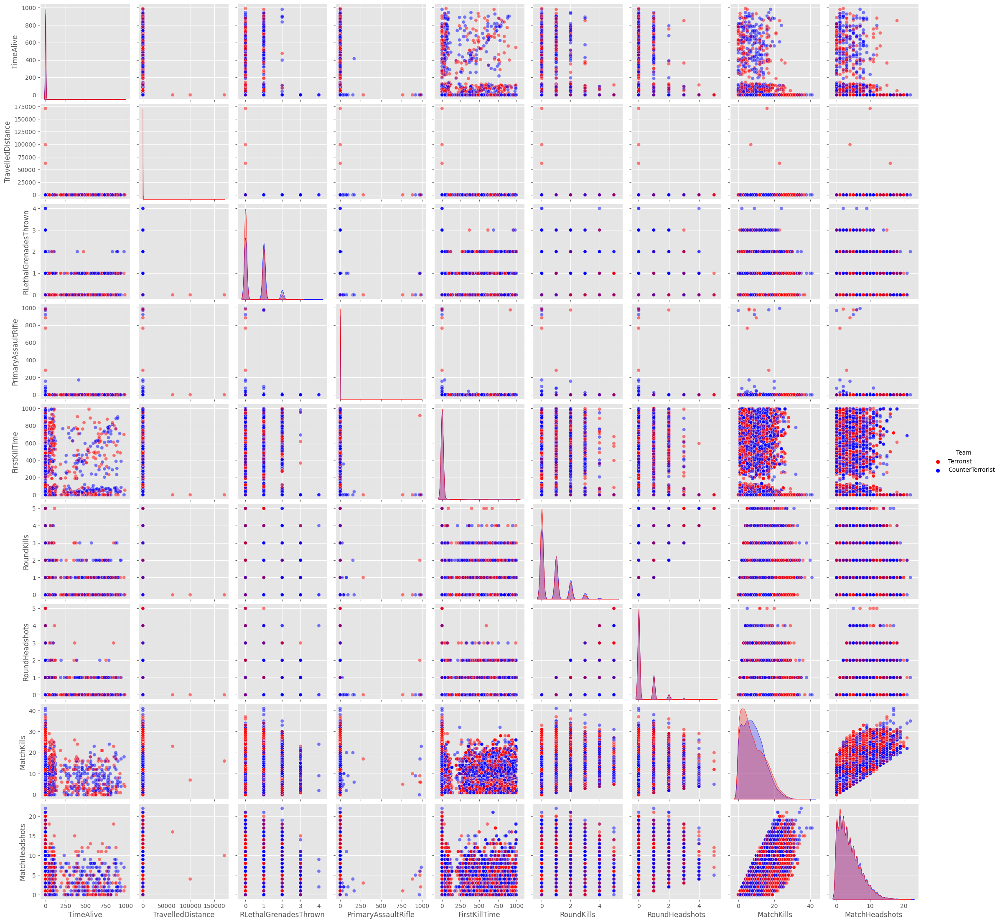

In [ ]:
# Supongamos que tienes un DataFrame llamado 'dft' con las columnas mencionadas

# Seleccionar las columnas relevantes para el análisis de relaciones
columns = ['Team', 'TimeAlive', 'TravelledDistance', 'RLethalGrenadesThrown', 'PrimaryAssaultRifle',
           'FirstKillTime', 'RoundKills', 'RoundHeadshots', 'MatchKills', 'MatchHeadshots']

# Filtrar el DataFrame con las columnas seleccionadas
dft_filtered = dft[columns]

# Crear un mapa de colores para los equipos
team_colors = {'Terrorist': 'red', 'CounterTerrorist': 'blue'}

# Mapear los colores según los valores de la columna 'Team'
colors = dft_filtered['Team'].map(team_colors)

sns.pairplot(dft_filtered, hue='Team', palette=team_colors, plot_kws={'alpha': 0.5})
# Mostrar la matriz de gráficos de dispersión
plt.show()


In [ ]:
dft.Map.unique()

array(['de_inferno', 'de_nuke', 'de_mirage', 'de_dust2'], dtype=object)

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Seleccionar las columnas relevantes para el análisis
columns = ['Map', 'TimeAlive', 'TravelledDistance', 'RLethalGrenadesThrown', 'PrimaryAssaultRifle',
           'FirstKillTime', 'RoundKills', 'RoundHeadshots', 'MatchKills', 'MatchHeadshots']

# Filtrar el dataframe solo para los valores de 'Team'
map_dft = dft[dft['Map'].notnull()]

# Crear un nuevo dataframe solo con las columnas seleccionadas
selected_dft = map_dft[columns]

# Calcular la matriz de correlación
correlation_matrix = selected_dft.corr()

# Plotear la matriz de correlación utilizando un heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Matriz de Correlación')

# Mostrar el gráfico
plt.show()

ValueError: could not convert string to float: 'de_inferno'

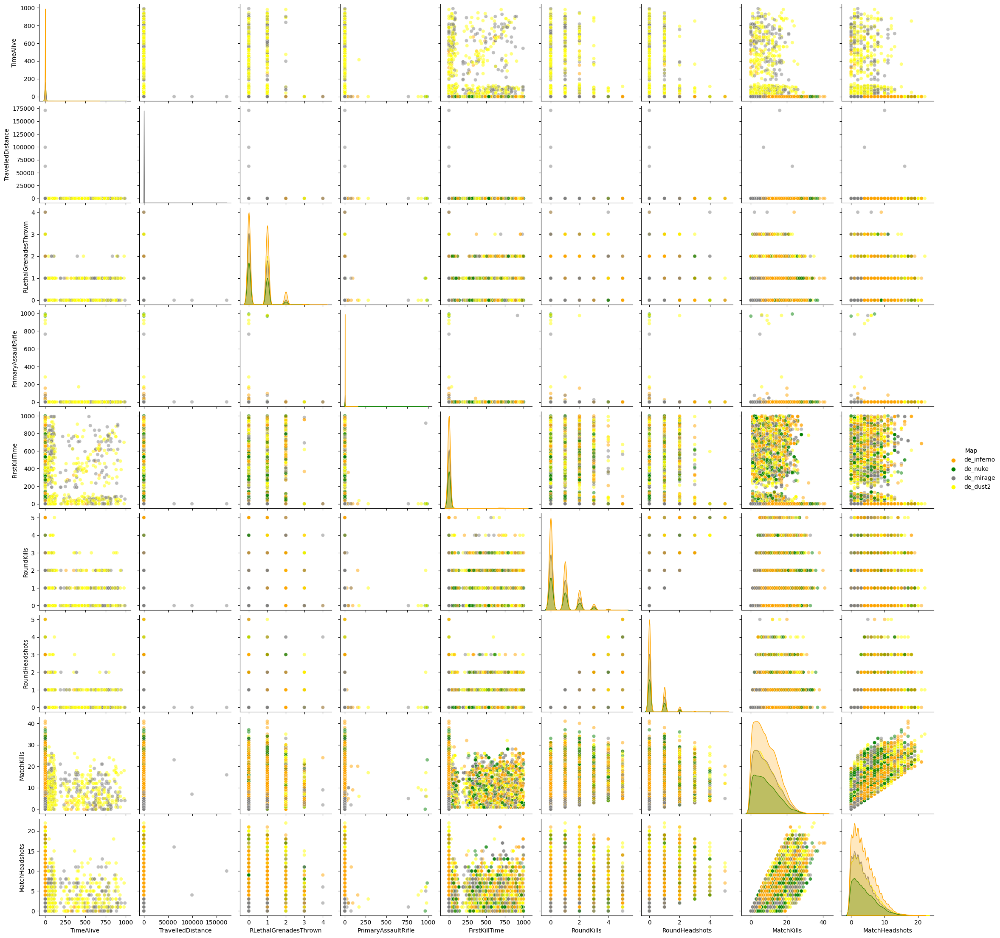

In [ ]:
# Supongamos que tienes un DataFrame llamado 'dft' con las columnas mencionadas

# Seleccionar las columnas relevantes para el análisis de relaciones
columns = ['Map', 'TimeAlive', 'TravelledDistance', 'RLethalGrenadesThrown', 'PrimaryAssaultRifle',
           'FirstKillTime', 'RoundKills', 'RoundHeadshots', 'MatchKills', 'MatchHeadshots']

# Filtrar el DataFrame con las columnas seleccionadas
dft_filtered = dft[columns]

# Crear un mapa de colores para los mapas
map_colors = {'de_inferno': 'orange', 'de_nuke': 'green', 'de_mirage': 'grey', 'de_dust2': 'yellow'}

# Mapear los colores según los valores de la columna 'Map'
colors = dft_filtered['Map'].map(map_colors)

sns.pairplot(dft_filtered, hue='Map', palette=map_colors, plot_kws={'alpha': 0.5})
# Mostrar la matriz de gráficos de dispersión
plt.show()

In [ ]:
# Importa las librerías a nuestro entorno de trabajo
import numpy as np
import pandas as pd
import seaborn as sb
import matplotlib.pyplot as plt
%matplotlib inline
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm
plt.rcParams['figure.figsize'] = (16, 9)
plt.style.use('ggplot')
from sklearn import linear_model
from sklearn.metrics import mean_squared_error, r2_score

In [ ]:
# Ahora veamos algunas estadísticas de nuestros datos
dft.FirstKillTime.describe()

count    79153.000000
mean        27.330373
std        135.433106
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max        999.000000
Name: FirstKillTime, dtype: float64

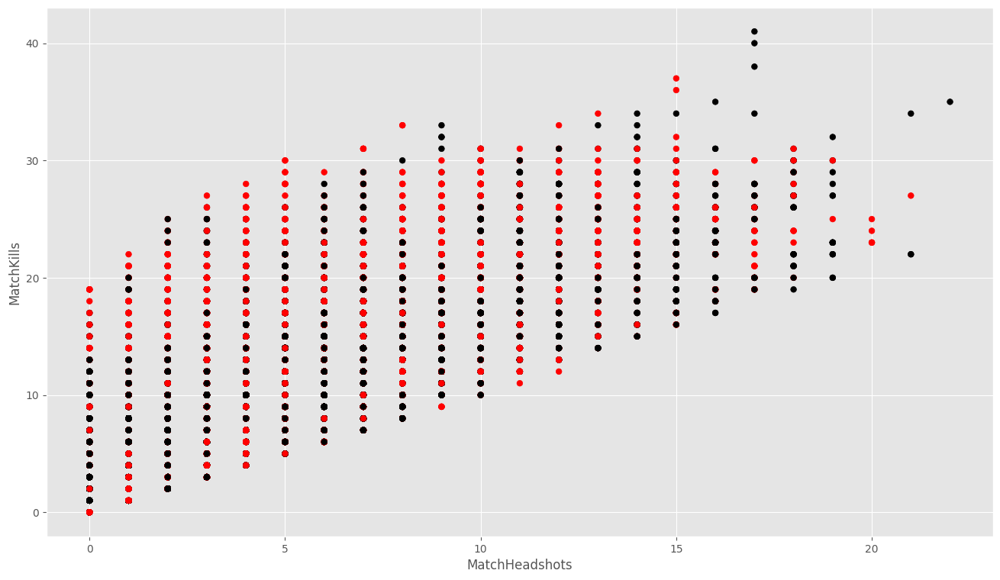

In [ ]:
#Visualizar los datos de entrada
colores=['red','black']
tamanios=[30,60]

f1 = dft['MatchHeadshots'].values
f2 = dft['MatchKills'].values

# Vamos a pintar en 2 colores los equipos
asignar=[]
for index, row in dft.iterrows():
    if(row['MatchHeadshots']<22) and (row['Team']=="Terrorist"):
      asignar.append(colores[0])
    else:
          asignar.append(colores[1])

plt.scatter(f1, f2, c=asignar, s=tamanios[0])

plt.xlabel('MatchHeadshots')
plt.ylabel('MatchKills')

plt.show()

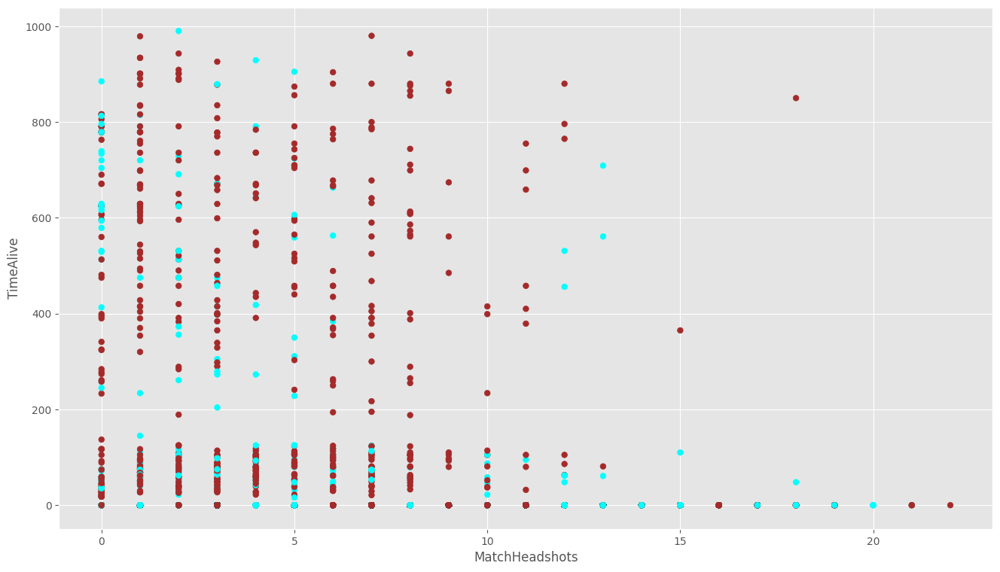

In [ ]:
#Visualizar los datos de entrada
colores=['cyan','brown']
tamanios=[30,60]

f1 = dft['MatchHeadshots'].values
f2 = dft['TimeAlive'].values

# Vamos a pintar en 2 colores los equipos
asignar=[]
for index, row in dft.iterrows():
    if(row['FirstKillTime']<100) and (row['Team']=="Terrorist"):
      asignar.append(colores[0])
    else:
          asignar.append(colores[1])

plt.scatter(f1, f2, c=asignar, s=tamanios[0])

plt.xlabel('MatchHeadshots')
plt.ylabel('TimeAlive')

plt.show()

Como podemos apreciar, existe  una relación proporcional, a mayor MatchHeadshots, mayor MatchKills

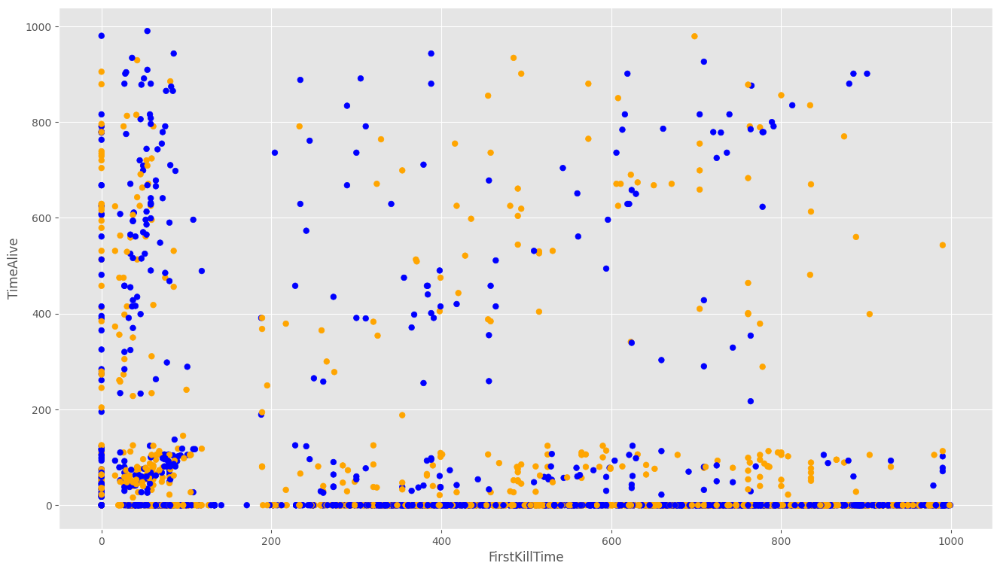

In [ ]:
#sb.scatterplot(x=dft.FirstKillTime, y=dft.TimeAlive)

#Visualizar los datos de entrada
colores=['orange','blue']
tamanios=[30,60]

f1 = dft['FirstKillTime'].values
f2 = dft['TimeAlive'].values

# Vamos a pintar en 2 colores los equipos
asignar=[]
for index, row in dft.iterrows():
    if(row['TimeAlive']<990) and (row['Team']=="Terrorist"):
      asignar.append(colores[0])
    else:
          asignar.append(colores[1])

plt.scatter(f1, f2, c=asignar, s=tamanios[0])

plt.xlabel('FirstKillTime')
plt.ylabel('TimeAlive')

plt.show()

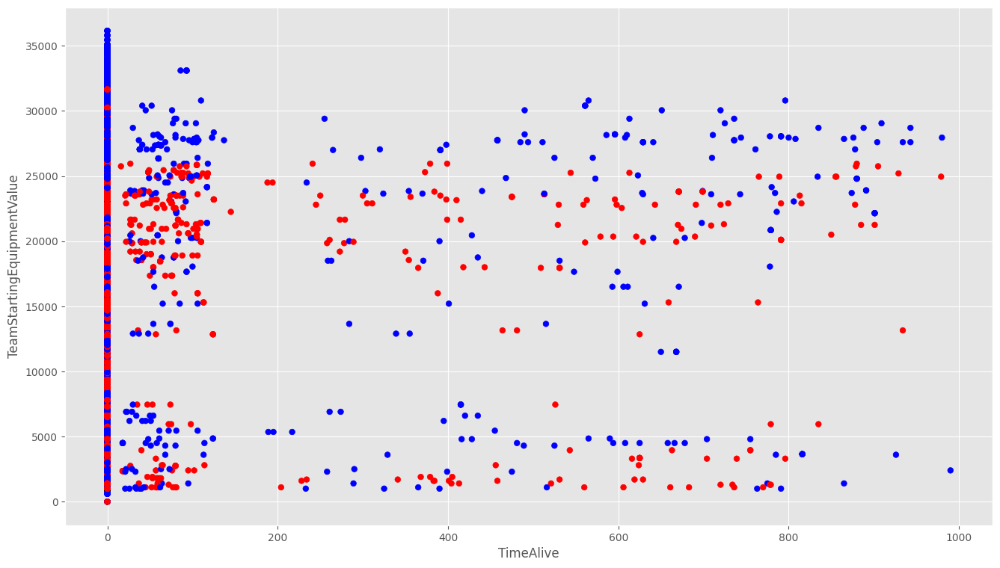

In [ ]:
#Visualizar los datos de entrada
colores=['red','blue']
tamanios=[30,60]

f1 = dft['TimeAlive'].values
f2 = dft['TeamStartingEquipmentValue'].values

# Vamos a pintar en 2 colores los equipos
asignar=[]
for index, row in dft.iterrows():
    if(row['TimeAlive']<990) and (row['Team']=="Terrorist"):
      asignar.append(colores[0])
    else:
          asignar.append(colores[1])

plt.scatter(f1, f2, c=asignar, s=tamanios[0])

plt.xlabel('TimeAlive')
plt.ylabel('TeamStartingEquipmentValue')

plt.show()

Según el gráfico, se ve representada la relación entre FirstKillTime y TimeAlive, en donde el color naranjo corresponde a Terrorist y el azul a CounterTerrorist

## Fase 4: Modeling

### Arbol de decision para regresion


In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeRegressor, DecisionTreeClassifier
from sklearn.metrics import mean_squared_error, accuracy_score, r2_score
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn import tree

In [ ]:
dft['Team'].fillna('Unknown', inplace=True)
# Transformamos las columnas de tipo object en números
dft['Map'] = dft['Map'].astype('category').cat.codes
dft['Team'] = dft['Team'].astype('category').cat.codes

Árbol de decisión para regresión.
Para el árbol de decisión de regresión, digamos que queremos predecir la 'MatchKills' de un jugador.

In [ ]:

X = dft.drop(['MatchKills'], axis=1)
y = dft['MatchKills']  # Queremos predecir 'MatchKills'

# Dividimos el conjunto de datos en entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Entrenamos el árbol de decisión
regressor = DecisionTreeRegressor(random_state=42, max_depth = 5)
regressor.fit(X_train, y_train)

# Realizamos la predicción y calculamos el error cuadrado medio
y_pred = regressor.predict(X_test)
print('Error cuadrado medio:', mean_squared_error(y_test, y_pred))

success_percentage = r2_score(y_test, y_pred) * 100
print('Porcentaje de éxito: %.2f%%' % success_percentage)


Error cuadrado medio: 7.757931985332866
Porcentaje de éxito: 79.91%


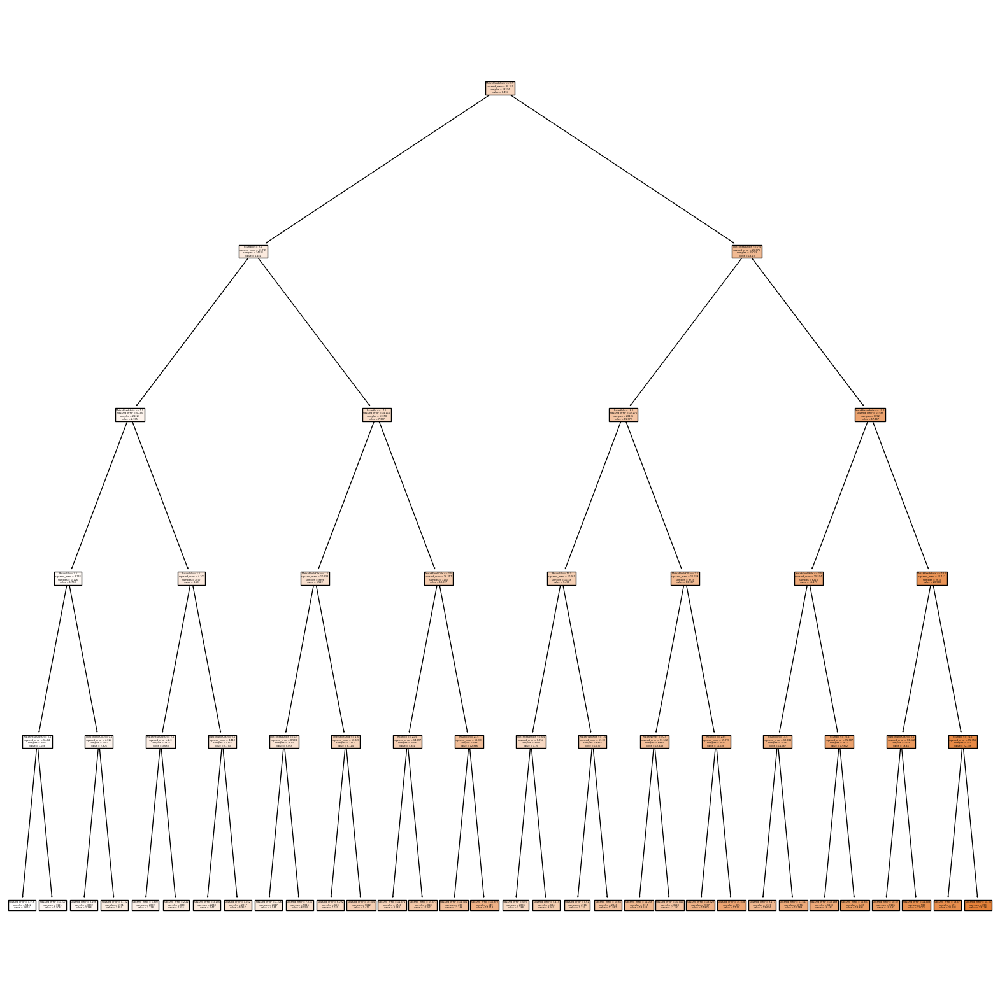

In [ ]:
fig, ax = plt.subplots(figsize=(20, 20))  # Grafico del arbol de decision para regresion

tree.plot_tree(regressor,
               feature_names=X.columns,
               filled=True,
               ax=ax)
plt.show()

In [ ]:
#Procedemos a realizar un proceso de optimización de hiperparámetros para mejorar el rendimiento del modelo

from sklearn.model_selection import GridSearchCV

# Definimos los valores que queremos probar para cada hiperparámetro
param_grid = {
    'max_depth': [5, 10, 15],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# Creamos un objeto GridSearchCV y lo ajustamos a nuestros datos de entrenamiento
regressor = DecisionTreeRegressor(random_state=42)
grid_search = GridSearchCV(regressor, param_grid, cv=5)
grid_search.fit(X_train, y_train)

# Obtenemos el mejor modelo y lo utilizamos para hacer predicciones en nuestros datos de prueba
best_regressor = grid_search.best_estimator_
y_pred = best_regressor.predict(X_test)

# Evaluamos el rendimiento del modelo
print('Error cuadrado medio:', mean_squared_error(y_test, y_pred))

#calculamos el coeficiente de determinación
success_percentage = r2_score(y_test, y_pred) * 100
print('Porcentaje de éxito: %.2f%%' % success_percentage)


Error cuadrado medio: 5.994726076147021
Porcentaje de éxito: 84.48%


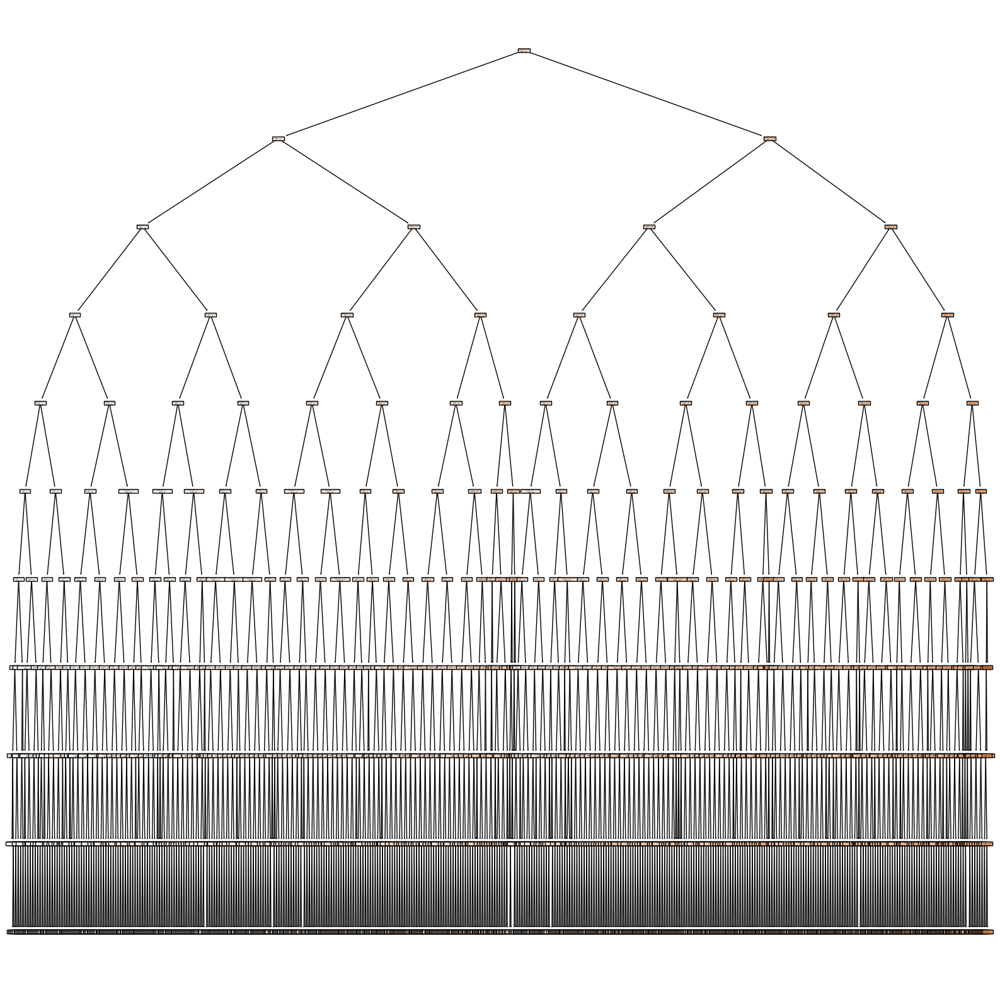

In [ ]:
fig, ax = plt.subplots(figsize=(20, 20))  # Grafico del arbol de decision para regresion optimizado
tree.plot_tree(best_regressor,
               feature_names=X.columns,
               filled=True,
               ax=ax)
plt.show()

### Arbol de decision para clasificacion

In [ ]:
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score
from sklearn import tree
import matplotlib.pyplot as plt


# Ahora vamos con el árbol de clasificación
# Supongamos que quieres predecir 'RoundWinner' en base a todas las demás columnas
X = dft.drop(['RoundWinner'], axis=1)
y = dft['RoundWinner']

# Dividimos tus datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Creacion y entrenamiento de un árbol de decisión para clasificación
classifier = DecisionTreeClassifier(random_state=42, max_depth = 5)
classifier.fit(X_train, y_train)

# predicción y evalúacion del rendimiento del clasificador

y_pred = classifier.predict(X_test)
print('Precisión de Clasificación: %', accuracy_score(y_test, y_pred)*100)


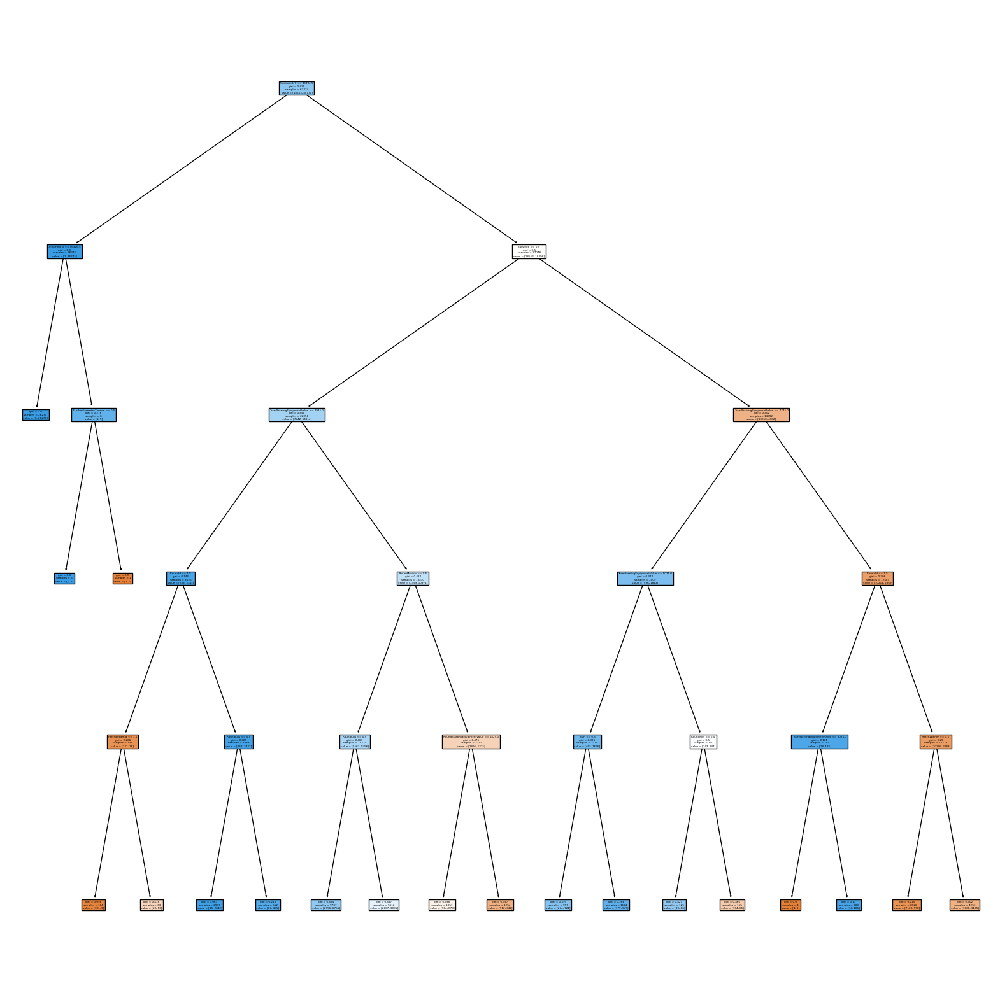

In [ ]:
plt.figure(figsize=(20, 20))
tree.plot_tree(classifier,
               feature_names=X.columns,
               filled=True)
plt.show()


Precisión de Clasificación: % 86.25568468923699


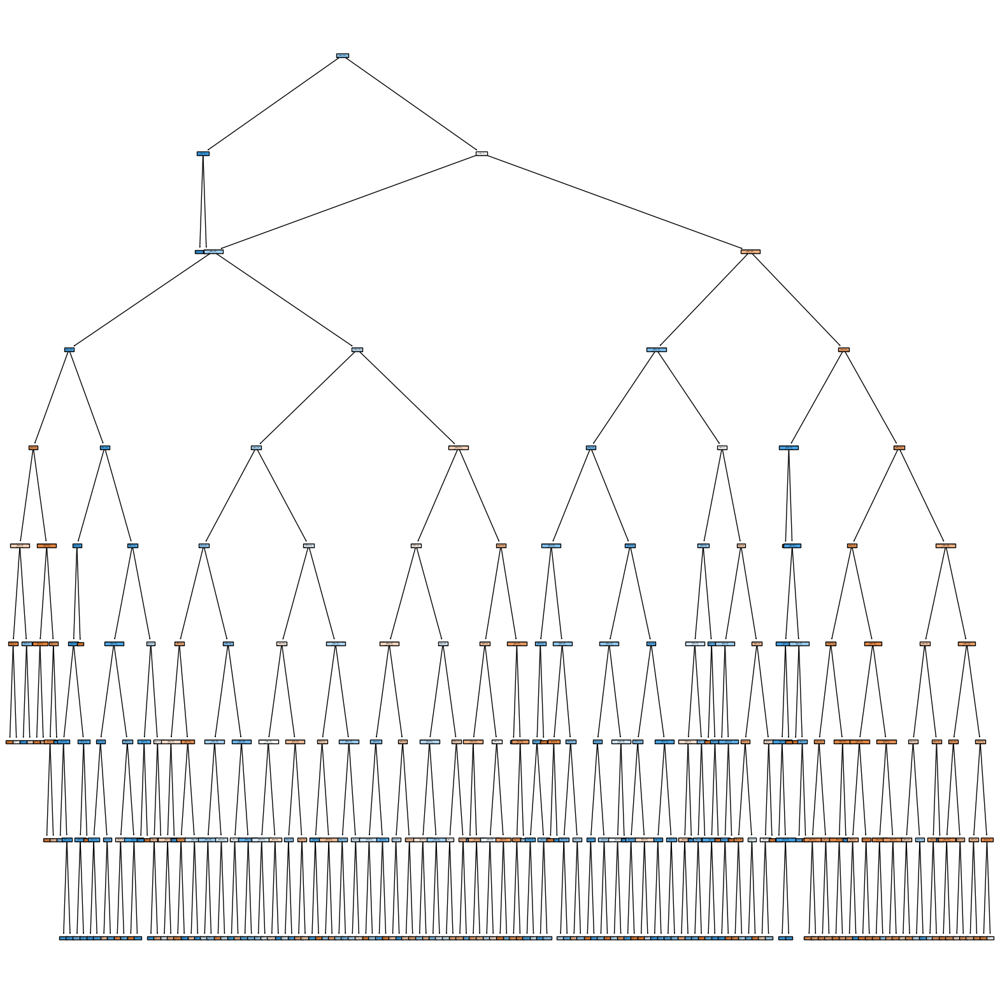

In [ ]:
# Definicion de los hiperparametros que queremos probar para la optimizacion
param_grid = {
    'max_depth': [3, 5, 7, 9],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# búsqueda de cuadrícula para encontrar los mejores hiperparámetros
grid_search = GridSearchCV(classifier, param_grid, cv=5)
grid_search.fit(X_train, y_train)

# Obtencion  del mejor modelo
best_classifier = grid_search.best_estimator_
y_pred = best_classifier.predict(X_test)

# Evaluamos el rendimiento del modelo
print('Precisión de Clasificación: %', accuracy_score(y_test, y_pred)*100)

# Visualizacion del árbol de decisión de clasificación optimizado
plt.figure(figsize=(20, 20))
tree.plot_tree(best_classifier,
               feature_names=X.columns,
               filled=True)
plt.show()


### Experimento con Keras para crear una red neuronal

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from keras.models import Sequential
from keras.layers import Dense
from keras.utils import to_categorical

# Division de los datos en conjuntos de entrenamiento y prueba
X = dft.drop(['RoundWinner'], axis=1)
y = dft['RoundWinner']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

y_train = to_categorical(y_train)
y_test = to_categorical(y_test)

# Normalizacion de los datos
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Creacion del modelo de red neuronal
model = Sequential()
model.add(Dense(64, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(2, activation='softmax')) # Change the number of output neurons to 2
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

# Entrenamiento del modelo
model.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_test, y_test))

# Evaluacion del rendimiento del modelo
loss, accuracy = model.evaluate(X_test, y_test)
print('Precisión: %.2f' % (accuracy*100))

Epoch 1/100
1979/1979 [==============================] - 17s 6ms/step - loss: 0.3454 - accuracy: 0.8345 - val_loss: 0.3192 - val_accuracy: 0.8486
Epoch 2/100
1979/1979 [==============================] - 13s 6ms/step - loss: 0.3123 - accuracy: 0.8488 - val_loss: 0.3090 - val_accuracy: 0.8538
Epoch 3/100
1979/1979 [==============================] - 11s 5ms/step - loss: 0.3033 - accuracy: 0.8535 - val_loss: 0.3014 - val_accuracy: 0.8560
Epoch 4/100
1979/1979 [==============================] - 10s 5ms/step - loss: 0.2986 - accuracy: 0.8558 - val_loss: 0.3054 - val_accuracy: 0.8547
Epoch 5/100
1979/1979 [==============================] - 11s 5ms/step - loss: 0.2937 - accuracy: 0.8588 - val_loss: 0.3025 - val_accuracy: 0.8547
Epoch 6/100
1979/1979 [==============================] - 10s 5ms/step - loss: 0.2921 - accuracy: 0.8586 - val_loss: 0.2994 - val_accuracy: 0.8574
Epoch 7/100
1979/1979 [==============================] - 10s 5ms/step - loss: 0.2886 - accuracy: 0.8608 - val_loss: 0.2936 -

### Uso del modelo en una prediccion

In [ ]:
# Definicion del conjunto de datos de muestra
sample = dft.sample(n=100, random_state=42)

# Obtencion de las features y la variable objetivo del sample
X_sample = sample.drop(['RoundWinner'], axis=1)
y_sample = sample['RoundWinner']

# Normalizar los datos del sample
X_sample = scaler.transform(X_sample)

# Obtener las predicciones del modelo para el sample
predictions = model.predict(X_sample)

# Convertir y_sample en una matriz de forma (100, 2)
y_sample = to_categorical(y_sample)

# Imprimir las predicciones y las etiquetas reales del sample
print('Predicciones:')
print(predictions.argmax(axis=1))
print('Etiquetas reales:')
print(y_sample.argmax(axis=1))
print(sum(predictions == y_sample) / len(predictions))


4/4 [==============================] - 0s 2ms/step
Predicciones:
[0 0 0 0 1 1 0 1 0 0 1 1 1 1 0 1 1 1 1 0 1 0 0 1 1 1 1 1 0 1 1 1 1 1 1 1 1
 0 0 1 0 1 1 1 1 1 1 0 1 1 1 1 0 1 1 0 1 1 1 1 1 1 1 0 1 1 1 1 1 0 1 0 1 1
 0 1 0 0 1 0 1 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 1 0 1]
Etiquetas reales:
[0 1 1 0 1 1 0 1 1 0 1 1 1 1 1 1 1 1 1 0 0 0 0 1 1 0 1 1 0 1 1 1 1 1 0 1 1
 0 0 1 0 1 1 1 1 1 1 1 1 0 1 1 0 1 1 0 1 1 1 1 0 1 1 1 0 1 1 1 0 0 0 0 1 1
 0 0 0 0 1 0 1 1 1 1 1 1 1 1 1 0 1 1 0 1 1 1 1 1 0 1]
[0.32 0.39]
